# Decision Tree

In [67]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np, pandas as pd, matplotlib.pyplot as plt
from sklearn import tree, metrics, model_selection, preprocessing
from IPython.display import Image, display
from sklearn.metrics import confusion_matrix, classification_report

df_train = pd.read_csv('ChurnData.csv')

In [68]:
del df_train['Unnamed: 0']

In [69]:
df_train.shape

(3333, 20)

In [70]:
df_train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,KS,128,area_code_415,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,no
1,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
2,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
3,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
4,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no


In [71]:
from sklearn.preprocessing import LabelEncoder

tras = LabelEncoder()

df_train['area_code_tr'] = tras.fit_transform(df_train['area_code'])

df_train.columns

del df_train['area_code']

df_train.columns

Index(['state', 'account_length', 'international_plan', 'voice_mail_plan',
       'number_vmail_messages', 'total_day_minutes', 'total_day_calls',
       'total_day_charge', 'total_eve_minutes', 'total_eve_calls',
       'total_eve_charge', 'total_night_minutes', 'total_night_calls',
       'total_night_charge', 'total_intl_minutes', 'total_intl_calls',
       'total_intl_charge', 'number_customer_service_calls', 'churn',
       'area_code_tr'],
      dtype='object')

In [72]:
df_train['target_churn_dum'] = pd.get_dummies(df_train.churn,prefix='churn',drop_first=True)
df_train.columns
del df_train['international_plan']
del df_train['voice_mail_plan']
del df_train['churn']
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 18 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state                          3333 non-null   object 
 1   account_length                 3333 non-null   int64  
 2   number_vmail_messages          3333 non-null   int64  
 3   total_day_minutes              3333 non-null   float64
 4   total_day_calls                3333 non-null   int64  
 5   total_day_charge               3333 non-null   float64
 6   total_eve_minutes              3333 non-null   float64
 7   total_eve_calls                3333 non-null   int64  
 8   total_eve_charge               3333 non-null   float64
 9   total_night_minutes            3333 non-null   float64
 10  total_night_calls              3333 non-null   int64  
 11  total_night_charge             3333 non-null   float64
 12  total_intl_minutes             3333 non-null   f

In [73]:
df_train.columns

Index(['state', 'account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'area_code_tr', 'target_churn_dum'],
      dtype='object')

In [74]:
from sklearn.model_selection import train_test_split

df_train.columns

X = df_train[['account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'area_code_tr']]
Y = df_train['target_churn_dum']

In [75]:
xtrain,xtest,ytrain,ytest=train_test_split(X,Y,test_size=0.20,stratify=Y)


In [76]:
tree.DecisionTreeClassifier() # plain tree model

DecisionTreeClassifier()

In [77]:
# default hyper-parameters for a decision tree classifier
class_weight=None, 
criterion='gini', 
max_depth=None,
max_features=None, 
max_leaf_nodes=None,
min_impurity_decrease=0.0, 
min_impurity_split=None,
min_samples_leaf=1, 
min_samples_split=2,
min_weight_fraction_leaf=0.0,
presort=False, 
random_state=None,
splitter='best'

In [78]:
dt1 = tree.DecisionTreeClassifier()
dt1.fit(xtrain,ytrain)
print(dt1.score(xtrain,ytrain))
print(dt1.score(xtest,ytest))

1.0
0.8830584707646177


In [79]:
dt2 = tree.DecisionTreeClassifier(max_depth=3)
dt2.fit(xtrain,ytrain)
print(dt2.score(xtrain,ytrain))
print(dt2.score(xtest,ytest))

0.904351087771943
0.9085457271364318


In [80]:
import pydotplus

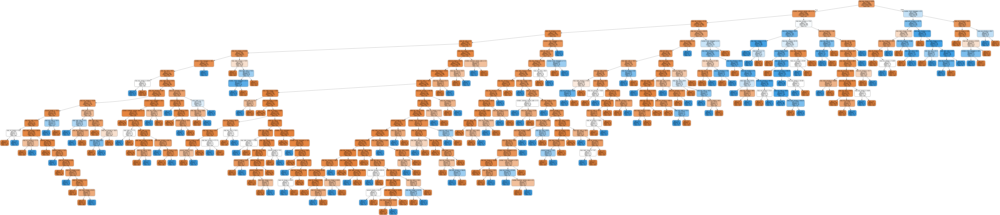

In [81]:
dot_data = tree.export_graphviz(dt1, out_file=None, filled=True, rounded=True,
                                feature_names=list(xtrain.columns),  
                                class_names=['yes','no'])
graph = pydotplus.graph_from_dot_data(dot_data)  
display(Image(graph.create_png()))

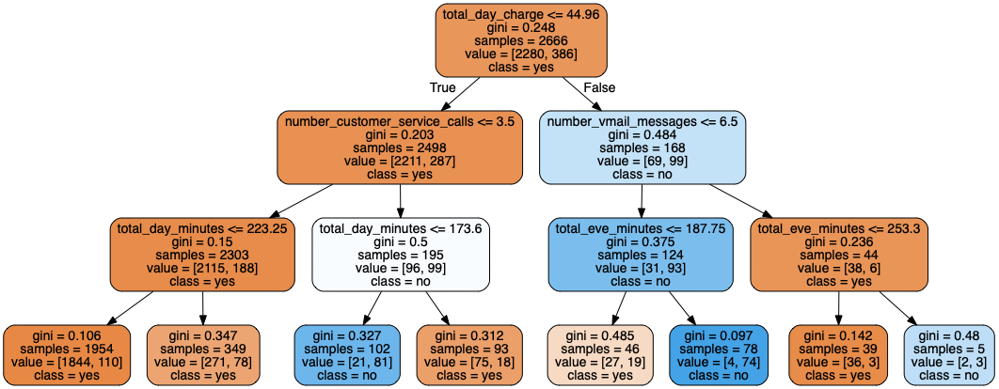

In [82]:
dot_data = tree.export_graphviz(dt2, out_file=None, filled=True, rounded=True,
                                feature_names=list(xtrain.columns),  
                                class_names=['yes','no'])
graph = pydotplus.graph_from_dot_data(dot_data)  
display(Image(graph.create_png()))

[Text(276.3029691835811, 212.49818181818182, 'X[4] <= 44.96\ngini = 0.248\nsamples = 2666\nvalue = [2280, 386]'),
 Text(234.344133015795, 202.61454545454546, 'X[14] <= 3.5\ngini = 0.203\nsamples = 2498\nvalue = [2211, 287]'),
 Text(190.59064768404514, 192.73090909090908, 'X[4] <= 37.95\ngini = 0.15\nsamples = 2303\nvalue = [2115, 188]'),
 Text(144.67526772916054, 182.84727272727272, 'X[11] <= 13.15\ngini = 0.106\nsamples = 1954\nvalue = [1844, 110]'),
 Text(102.60675421750956, 172.96363636363637, 'X[12] <= 2.5\ngini = 0.084\nsamples = 1677\nvalue = [1603, 74]'),
 Text(47.19045868862099, 163.07999999999998, 'X[7] <= 25.485\ngini = 0.196\nsamples = 335\nvalue = [298, 37]'),
 Text(35.31593648926786, 153.19636363636363, 'X[1] <= 46.5\ngini = 0.174\nsamples = 321\nvalue = [290, 31]'),
 Text(33.74087033225522, 143.31272727272727, 'X[3] <= 46.5\ngini = 0.17\nsamples = 320\nvalue = [290, 30]'),
 Text(25.299500147015586, 133.42909090909092, 'X[4] <= 24.99\ngini = 0.5\nsamples = 4\nvalue = [2, 2

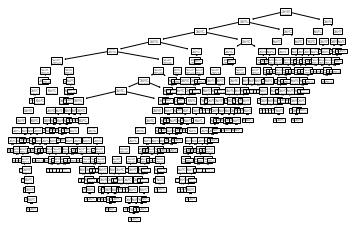

In [83]:
tree.plot_tree(dt1)

[Text(167.4, 190.26, 'X[4] <= 44.96\ngini = 0.248\nsamples = 2666\nvalue = [2280, 386]'),
 Text(83.7, 135.9, 'X[14] <= 3.5\ngini = 0.203\nsamples = 2498\nvalue = [2211, 287]'),
 Text(41.85, 81.53999999999999, 'X[2] <= 223.25\ngini = 0.15\nsamples = 2303\nvalue = [2115, 188]'),
 Text(20.925, 27.180000000000007, 'gini = 0.106\nsamples = 1954\nvalue = [1844, 110]'),
 Text(62.775000000000006, 27.180000000000007, 'gini = 0.347\nsamples = 349\nvalue = [271, 78]'),
 Text(125.55000000000001, 81.53999999999999, 'X[2] <= 173.6\ngini = 0.5\nsamples = 195\nvalue = [96, 99]'),
 Text(104.625, 27.180000000000007, 'gini = 0.327\nsamples = 102\nvalue = [21, 81]'),
 Text(146.475, 27.180000000000007, 'gini = 0.312\nsamples = 93\nvalue = [75, 18]'),
 Text(251.10000000000002, 135.9, 'X[1] <= 6.5\ngini = 0.484\nsamples = 168\nvalue = [69, 99]'),
 Text(209.25, 81.53999999999999, 'X[5] <= 187.75\ngini = 0.375\nsamples = 124\nvalue = [31, 93]'),
 Text(188.32500000000002, 27.180000000000007, 'gini = 0.485\nsamp

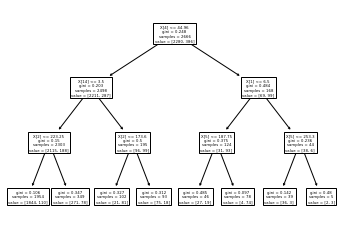

In [84]:
tree.plot_tree(dt2)

In [85]:
from sklearn.tree import export_text
r = export_text(dt1,feature_names=list(xtrain.columns))
print(r)

|--- total_day_charge <= 44.96
|   |--- number_customer_service_calls <= 3.50
|   |   |--- total_day_charge <= 37.95
|   |   |   |--- total_intl_minutes <= 13.15
|   |   |   |   |--- total_intl_calls <= 2.50
|   |   |   |   |   |--- total_eve_charge <= 25.49
|   |   |   |   |   |   |--- number_vmail_messages <= 46.50
|   |   |   |   |   |   |   |--- total_day_calls <= 46.50
|   |   |   |   |   |   |   |   |--- total_day_charge <= 24.99
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- total_day_charge >  24.99
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |--- total_day_calls >  46.50
|   |   |   |   |   |   |   |   |--- total_night_calls <= 124.50
|   |   |   |   |   |   |   |   |   |--- total_eve_minutes <= 189.70
|   |   |   |   |   |   |   |   |   |   |--- total_eve_charge <= 15.28
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 10
|   |   |   |   |   |   |   |   |   |   |--- total_eve_c

In [86]:
from sklearn.tree import export_text
r = export_text(dt2,feature_names=list(xtrain.columns))
print(r)

|--- total_day_charge <= 44.96
|   |--- number_customer_service_calls <= 3.50
|   |   |--- total_day_minutes <= 223.25
|   |   |   |--- class: 0
|   |   |--- total_day_minutes >  223.25
|   |   |   |--- class: 0
|   |--- number_customer_service_calls >  3.50
|   |   |--- total_day_minutes <= 173.60
|   |   |   |--- class: 1
|   |   |--- total_day_minutes >  173.60
|   |   |   |--- class: 0
|--- total_day_charge >  44.96
|   |--- number_vmail_messages <= 6.50
|   |   |--- total_eve_minutes <= 187.75
|   |   |   |--- class: 0
|   |   |--- total_eve_minutes >  187.75
|   |   |   |--- class: 1
|   |--- number_vmail_messages >  6.50
|   |   |--- total_eve_minutes <= 253.30
|   |   |   |--- class: 0
|   |   |--- total_eve_minutes >  253.30
|   |   |   |--- class: 1



In [105]:
list(zip(dt1.feature_importances_,xtrain.columns))

[(0.04272809284282734, 'account_length'),
 (0.09203724904036586, 'number_vmail_messages'),
 (0.08975456027820773, 'total_day_minutes'),
 (0.048773691218710565, 'total_day_calls'),
 (0.19358046504095058, 'total_day_charge'),
 (0.10158716563587206, 'total_eve_minutes'),
 (0.030261976467598, 'total_eve_calls'),
 (0.06478053266773766, 'total_eve_charge'),
 (0.04366425040105811, 'total_night_minutes'),
 (0.043457413804182485, 'total_night_calls'),
 (0.04403826596864748, 'total_night_charge'),
 (0.033191769397536694, 'total_intl_minutes'),
 (0.020584553068362647, 'total_intl_calls'),
 (0.027877407922169875, 'total_intl_charge'),
 (0.10565437060021393, 'number_customer_service_calls'),
 (0.01802823564555904, 'area_code_tr')]

In [207]:
# extract the arrays that define the tree
children_left = dt2.tree_.children_left
children_right = dt2.tree_.children_right
children_default = children_right.copy() # because sklearn does not use missing values
features = dt2.tree_.feature
thresholds = dt2.tree_.threshold
values = dt2.tree_.value.reshape(dt2.tree_.value.shape[0], 2)
node_sample_weight = dt2.tree_.weighted_n_node_samples

In [208]:
print("     children_left", children_left) 
# note that negative children values mean this is a leaf node
print("    children_right", children_right)
print("  children_default", children_default)
print("          features", features)
print("        thresholds", thresholds.round(3))
print("            values", values.round(3))
print("node_sample_weight", node_sample_weight)

     children_left [ 1  2  3 -1 -1  6 -1 -1  9 10 -1 -1 13 -1 -1]
    children_right [ 8  5  4 -1 -1  7 -1 -1 12 11 -1 -1 14 -1 -1]
  children_default [ 8  5  4 -1 -1  7 -1 -1 12 11 -1 -1 14 -1 -1]
          features [ 4 14  2 -2 -2  2 -2 -2  1  5 -2 -2  5 -2 -2]
        thresholds [ 44.96   3.5  223.25  -2.    -2.   173.6   -2.    -2.     6.5  187.75
  -2.    -2.   253.3   -2.    -2.  ]
            values [[2.280e+03 3.860e+02]
 [2.211e+03 2.870e+02]
 [2.115e+03 1.880e+02]
 [1.844e+03 1.100e+02]
 [2.710e+02 7.800e+01]
 [9.600e+01 9.900e+01]
 [2.100e+01 8.100e+01]
 [7.500e+01 1.800e+01]
 [6.900e+01 9.900e+01]
 [3.100e+01 9.300e+01]
 [2.700e+01 1.900e+01]
 [4.000e+00 7.400e+01]
 [3.800e+01 6.000e+00]
 [3.600e+01 3.000e+00]
 [2.000e+00 3.000e+00]]
node_sample_weight [2666. 2498. 2303. 1954.  349.  195.  102.   93.  168.  124.   46.   78.
   44.   39.    5.]


In [209]:
# define a custom tree model
tree_dict = {
    "children_left": children_left,
    "children_right": children_right,
    "children_default": children_default,
    "features": features,
    "thresholds": thresholds,
    "values": values,
    "node_sample_weight": node_sample_weight
}
model = {
    "trees": [tree_dict]
}

In [108]:
import shap
explainer = shap.TreeExplainer(model)

In [109]:
# Provide Probability as Output
def model_churn_proba(x):
    return dt2.predict_proba(x)[:,1]

# Provide Log Odds as Output
def model_churn_log_odds(x):
    p = dt2.predict_log_proba(x)
    return p[:,1] - p[:,0]

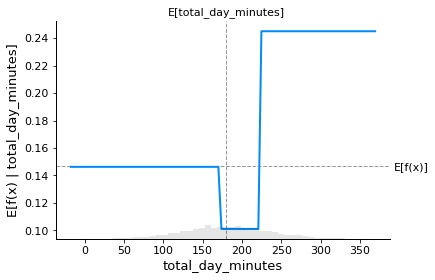

In [213]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "total_day_minutes", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

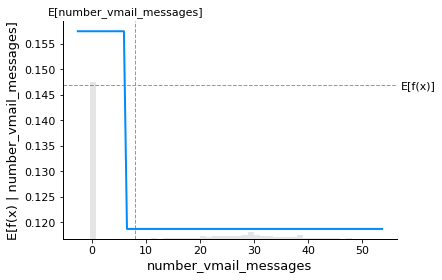

In [132]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "number_vmail_messages", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

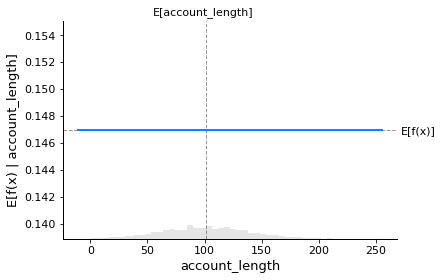

In [199]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "account_length", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

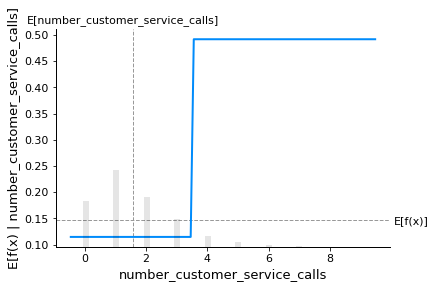

In [200]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "number_customer_service_calls", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

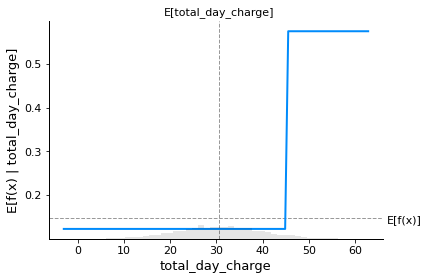

In [201]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "total_day_charge", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

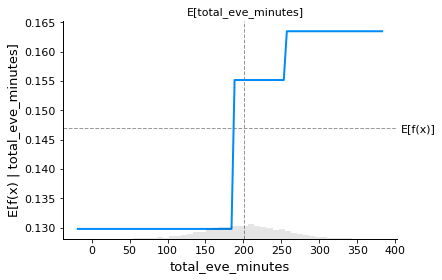

In [202]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "total_eve_minutes", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

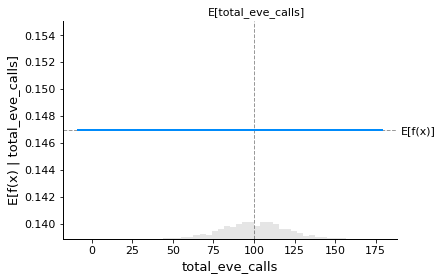

In [205]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "total_eve_calls", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

In [133]:
shap_values_churn.feature_names

['account_length',
 'number_vmail_messages',
 'total_day_minutes',
 'total_day_calls',
 'total_day_charge',
 'total_eve_minutes',
 'total_eve_calls',
 'total_eve_charge',
 'total_night_minutes',
 'total_night_calls',
 'total_night_charge',
 'total_intl_minutes',
 'total_intl_calls',
 'total_intl_charge',
 'number_customer_service_calls',
 'area_code_tr']

In [138]:
temp_df = pd.DataFrame()
temp_df['Feature Name'] = pd.Series(X.columns)
temp_df['Score'] = pd.Series(dt2.feature_importances_.flatten())
temp_df.sort_values(by='Score',ascending=False)

,Feature Name,Score
4,total_day_charge,0.306375
14,number_customer_service_calls,0.282235
2,total_day_minutes,0.223336
1,number_vmail_messages,0.105760
5,total_eve_minutes,0.082294
0,account_length,0.000000
3,total_day_calls,0.000000
6,total_eve_calls,0.000000
7,total_eve_charge,0.000000
8,total_night_minutes,0.000000


In [139]:
# LIME

In [140]:
import lime
import lime.lime_tabular

explainer = lime.lime_tabular.LimeTabularExplainer(np.array(xtrain),
                    feature_names=list(xtrain.columns), 
                    class_names=['target_churn_dum'], 
                    verbose=True, mode='classification')

In [141]:
# this record is a no churn scenario
exp = explainer.explain_instance(xtest.iloc[0], dt2.predict_proba, 
                                 num_features=16)
exp.as_list()

Intercept 0.22399398319152197
Prediction_local [0.02017902]
Right: 0.05629477993858751


[('number_customer_service_calls <= 1.00', -0.08103355701669067),
 ('179.70 < total_day_minutes <= 216.20', -0.08093813226005755),
 ('30.55 < total_day_charge <= 36.75', -0.04145866831528389),
 ('number_vmail_messages <= 0.00', 0.04141941235064439),
 ('87.00 < total_eve_calls <= 100.00', -0.016182514522118874),
 ('account_length > 127.00', -0.012292493741915529),
 ('166.25 < total_eve_minutes <= 200.60', -0.007532679938086811),
 ('total_night_charge <= 7.52', -0.005310111723621769),
 ('8.50 < total_intl_minutes <= 10.30', 0.004310236421158718),
 ('area_code_tr <= 0.00', -0.0035093388573777667),
 ('14.13 < total_eve_charge <= 17.05', 0.0033744947393262482),
 ('total_day_calls <= 87.00', -0.0030304504011692086),
 ('total_intl_calls > 6.00', -0.0029068224596008074),
 ('2.30 < total_intl_charge <= 2.78', 0.0019401442842366429),
 ('total_night_minutes <= 167.22', -0.0009125689361201153),
 ('101.00 < total_night_calls <= 114.00', 0.0002480876132392171)]

In [142]:
pd.DataFrame(exp.as_list())

,0,1
0,number_customer_service_calls <= 1.00,-0.081034
1,179.70 < total_day_minutes <= 216.20,-0.080938
2,30.55 < total_day_charge <= 36.75,-0.041459
3,number_vmail_messages <= 0.00,0.041419
4,87.00 < total_eve_calls <= 100.00,-0.016183
5,account_length > 127.00,-0.012292
6,166.25 < total_eve_minutes <= 200.60,-0.007533
7,total_night_charge <= 7.52,-0.005310
8,8.50 < total_intl_minutes <= 10.30,0.004310
9,area_code_tr <= 0.00,-0.003509


In [143]:
exp.show_in_notebook(show_table=True)

In [144]:
# This is s churn scenario
exp = explainer.explain_instance(xtest.iloc[20], dt2.predict_proba, num_features=16)
exp.as_list()

Intercept 0.1996460119198059
Prediction_local [0.0878692]
Right: 0.05629477993858751


[('number_customer_service_calls <= 1.00', -0.08857195103680407),
 ('24.46 < total_day_charge <= 30.55', -0.031466609467593956),
 ('number_vmail_messages <= 0.00', 0.029799061168315828),
 ('143.90 < total_day_minutes <= 179.70', -0.0252488919329984),
 ('total_eve_minutes > 235.75', 0.018701875163242593),
 ('account_length <= 74.00', -0.011244138068281798),
 ('200.65 < total_night_minutes <= 235.67', -0.009959446580145226),
 ('3.00 < total_intl_calls <= 4.00', 0.007101382202083709),
 ('total_eve_calls <= 87.00', 0.006721845757737639),
 ('8.50 < total_intl_minutes <= 10.30', 0.005937388702802898),
 ('2.30 < total_intl_charge <= 2.78', -0.005137628728205146),
 ('total_eve_charge > 20.04', -0.003925675039973504),
 ('100.00 < total_day_calls <= 114.00', -0.002605577435621319),
 ('9.03 < total_night_charge <= 10.61', -0.0018234843257517745),
 ('total_night_calls <= 87.00', -0.0017043473934393106),
 ('area_code_tr <= 0.00', 0.0016493882611883037)]

In [145]:
exp.show_in_notebook(show_table=True)

In [146]:
xtest.iloc[20]

account_length                    63.00
number_vmail_messages              0.00
total_day_minutes                149.30
total_day_calls                  104.00
total_day_charge                  25.38
total_eve_minutes                273.60
total_eve_calls                   75.00
total_eve_charge                  23.26
total_night_minutes              206.60
total_night_calls                 72.00
total_night_charge                 9.30
total_intl_minutes                 9.10
total_intl_calls                   4.00
total_intl_charge                  2.46
number_customer_service_calls      0.00
area_code_tr                       0.00
Name: 697, dtype: float64

In [147]:
ytest.iloc[20]

0

In [149]:
dt2.predict(xtest)[20]

0

In [150]:
explainer = lime.lime_tabular.LimeTabularExplainer(np.array(xtrain),
                    feature_names=list(xtrain.columns), 
                    class_names=['target_churn_dum'], 
                    verbose=True, mode='classification')
# Code for SP-LIME
import warnings
from lime import submodular_pick

# SP-LIME returns exaplanations on a sample set to provide a non redundant global decision boundary of original model
sp_obj = submodular_pick.SubmodularPick(explainer, np.array(xtrain), 
                                        dt2.predict_proba, 
                                        num_features=14,
                                        num_exps_desired=10)

Intercept 0.7454859996152182
Prediction_local [0.98833517]
Right: 0.9437052200614124
Intercept 0.840396816681158
Prediction_local [0.79843663]
Right: 0.9437052200614124
Intercept 0.858645072123191
Prediction_local [0.86322355]
Right: 0.9437052200614124
Intercept 0.9537874743325827
Prediction_local [0.51848658]
Right: 0.9437052200614124
Intercept 0.913401417617839
Prediction_local [0.70393372]
Right: 0.7765042979942693
Intercept 0.8032891448620758
Prediction_local [0.92439416]
Right: 0.9437052200614124
Intercept 0.8550884290135073
Prediction_local [0.75465519]
Right: 0.7765042979942693
Intercept 0.7694217645462801
Prediction_local [0.96397738]
Right: 0.9437052200614124
Intercept 0.9245442167321758
Prediction_local [0.5704195]
Right: 0.9230769230769231
Intercept 0.7534903116236413
Prediction_local [1.00176116]
Right: 0.9437052200614124
Intercept 0.846489603451419
Prediction_local [0.77831204]
Right: 0.9437052200614124
Intercept 0.847670309976662
Prediction_local [0.76782712]
Right: 0.776

Intercept 0.8273245838526206
Prediction_local [0.87185774]
Right: 0.9437052200614124
Intercept 0.795542883515542
Prediction_local [0.89989233]
Right: 0.9437052200614124
Intercept 0.7804259725037926
Prediction_local [0.95259522]
Right: 0.9437052200614124
Intercept 0.9419477469677662
Prediction_local [0.54035698]
Right: 0.5869565217391305
Intercept 0.8024862303626177
Prediction_local [0.9096991]
Right: 0.9437052200614124
Intercept 0.7781868314667667
Prediction_local [0.99761126]
Right: 0.9437052200614124
Intercept 0.8056277707795528
Prediction_local [0.89054092]
Right: 0.9437052200614124
Intercept 0.7706426232726925
Prediction_local [0.94295331]
Right: 0.9437052200614124
Intercept 0.7789724346146668
Prediction_local [0.99175152]
Right: 0.9437052200614124
Intercept 0.8036317460000825
Prediction_local [0.9148501]
Right: 0.9437052200614124
Intercept 0.7872043028447804
Prediction_local [0.96104611]
Right: 0.9437052200614124
Intercept 0.938309462712442
Prediction_local [0.53905838]
Right: 0.7

Intercept 0.8427053465677738
Prediction_local [0.89202483]
Right: 0.9437052200614124
Intercept 0.7713045003247412
Prediction_local [0.93335276]
Right: 0.9437052200614124
Intercept 0.7423070236756545
Prediction_local [0.98667711]
Right: 0.9437052200614124
Intercept 0.7630592706832048
Prediction_local [0.92366202]
Right: 0.9437052200614124
Intercept 0.815944204029633
Prediction_local [0.96520869]
Right: 0.9437052200614124
Intercept 0.8582561996952282
Prediction_local [0.70603015]
Right: 0.7765042979942693
Intercept 0.7982543453447576
Prediction_local [0.92767731]
Right: 0.9437052200614124
Intercept 0.8101733199064483
Prediction_local [0.92372808]
Right: 0.9437052200614124
Intercept 0.811050668803641
Prediction_local [0.91737656]
Right: 0.9437052200614124
Intercept 0.8104425357498379
Prediction_local [0.8881531]
Right: 0.9437052200614124
Intercept 0.7982195307892657
Prediction_local [0.90579958]
Right: 0.9437052200614124
Intercept 0.8257357847951813
Prediction_local [0.77435397]
Right: 0.

Intercept 0.8245224492043239
Prediction_local [0.94454244]
Right: 0.9437052200614124
Intercept 0.8488803198502171
Prediction_local [0.89009766]
Right: 0.9437052200614124
Intercept 0.9524005158760154
Prediction_local [0.50570015]
Right: 0.8064516129032258
Intercept 0.9030424806302563
Prediction_local [0.70732497]
Right: 0.7765042979942693
Intercept 0.817066625553691
Prediction_local [0.86061926]
Right: 0.9437052200614124
Intercept 0.780984852820047
Prediction_local [0.95737824]
Right: 0.9437052200614124
Intercept 0.8601186381118497
Prediction_local [0.74623933]
Right: 0.7765042979942693
Intercept 0.09084981057197843
Prediction_local [0.33637044]
Right: 0.7941176470588235
Intercept 0.8248098935053669
Prediction_local [0.85942948]
Right: 0.9437052200614124
Intercept 0.8692131860109189
Prediction_local [0.68251421]
Right: 0.7765042979942693
Intercept 0.8757361835042955
Prediction_local [0.75634379]
Right: 0.8064516129032258
Intercept 0.7793736990912451
Prediction_local [0.96591373]
Right: 

Intercept 0.8605399446811948
Prediction_local [0.69878503]
Right: 0.7765042979942693
Intercept 0.8057094747051283
Prediction_local [0.88934873]
Right: 0.9437052200614124
Intercept 0.8772135496591867
Prediction_local [0.70436402]
Right: 0.5869565217391305
Intercept 0.7848004346668377
Prediction_local [0.96272581]
Right: 0.9437052200614124
Intercept 0.8214270706927477
Prediction_local [0.96398986]
Right: 0.9437052200614124
Intercept 0.8991805806043585
Prediction_local [0.71169779]
Right: 0.7765042979942693
Intercept 0.7614639777988389
Prediction_local [0.92336428]
Right: 0.9437052200614124
Intercept 0.7660200773174529
Prediction_local [0.91693944]
Right: 0.9437052200614124
Intercept 0.8410242672924136
Prediction_local [0.89211854]
Right: 0.9437052200614124
Intercept 0.8313045051169711
Prediction_local [0.82265141]
Right: 0.8064516129032258
Intercept 0.7865510818480346
Prediction_local [0.90999905]
Right: 0.9437052200614124
Intercept 0.8515460194147338
Prediction_local [0.73958104]
Right:

Intercept 0.1251473383702687
Prediction_local [0.3006001]
Right: 0.9487179487179487
Intercept 0.7467297314204984
Prediction_local [0.97761716]
Right: 0.9437052200614124
Intercept 0.7923903578809124
Prediction_local [0.96671664]
Right: 0.9437052200614124
Intercept 0.8066364345125242
Prediction_local [0.89307725]
Right: 0.9437052200614124
Intercept 0.7925321696452996
Prediction_local [0.90484535]
Right: 0.9437052200614124
Intercept 0.8758335999438206
Prediction_local [0.68782849]
Right: 0.5869565217391305
Intercept 0.7644844256357464
Prediction_local [0.94386514]
Right: 0.9437052200614124
Intercept 0.917083801460992
Prediction_local [0.67710062]
Right: 0.7765042979942693
Intercept 0.815040026630335
Prediction_local [0.85655224]
Right: 0.9437052200614124
Intercept 0.810401119486921
Prediction_local [0.90410825]
Right: 0.9437052200614124
Intercept 0.8580694346737362
Prediction_local [0.77935339]
Right: 0.8064516129032258
Intercept 0.7954040686966596
Prediction_local [0.92819715]
Right: 0.9

Intercept 0.7997701916510329
Prediction_local [0.89279093]
Right: 0.9437052200614124
Intercept 0.7977935422836253
Prediction_local [0.91418389]
Right: 0.9437052200614124
Intercept 0.8271411036416713
Prediction_local [0.74941991]
Right: 0.7765042979942693
Intercept 0.7932948206270543
Prediction_local [0.9481231]
Right: 0.9437052200614124
Intercept 0.8398042815250669
Prediction_local [0.86634705]
Right: 0.9437052200614124
Intercept 0.835763645262896
Prediction_local [0.72385606]
Right: 0.7765042979942693
Intercept 0.7838287903671546
Prediction_local [0.97121651]
Right: 0.9437052200614124
Intercept 0.8562325073637946
Prediction_local [0.72504045]
Right: 0.7765042979942693
Intercept 0.8991939709385324
Prediction_local [0.71476497]
Right: 0.5869565217391305
Intercept 0.7926880522862342
Prediction_local [0.91738341]
Right: 0.9437052200614124
Intercept 0.7759794772542946
Prediction_local [0.90806302]
Right: 0.9437052200614124
Intercept 0.8155369420743405
Prediction_local [0.86218573]
Right: 0

Intercept 0.12813870183792325
Prediction_local [0.30839535]
Right: 0.9487179487179487
Intercept 0.7874721959408334
Prediction_local [0.90892755]
Right: 0.9437052200614124
Intercept 0.8186613091518415
Prediction_local [0.95649527]
Right: 0.9437052200614124
Intercept 0.8040709425833161
Prediction_local [0.88569558]
Right: 0.9437052200614124
Intercept 0.774300860319228
Prediction_local [0.94218767]
Right: 0.9437052200614124
Intercept 0.8290402780872468
Prediction_local [0.94235038]
Right: 0.9437052200614124
Intercept 0.7640499093748467
Prediction_local [0.93973189]
Right: 0.9437052200614124
Intercept 0.8168606678137629
Prediction_local [0.92188573]
Right: 0.9437052200614124
Intercept 0.7989712891902238
Prediction_local [0.90881274]
Right: 0.9437052200614124
Intercept 0.8635657039096003
Prediction_local [0.72284514]
Right: 0.5869565217391305
Intercept 0.8329348335714366
Prediction_local [0.90590153]
Right: 0.9437052200614124
Intercept 0.7723519015968198
Prediction_local [0.9845351]
Right: 

Intercept 0.751837930838744
Prediction_local [0.94112711]
Right: 0.9437052200614124
Intercept 0.7981153616458804
Prediction_local [0.91407466]
Right: 0.9437052200614124
Intercept 0.8068836240523996
Prediction_local [0.98666505]
Right: 0.9437052200614124
Intercept 0.8411180494571047
Prediction_local [0.89158238]
Right: 0.9437052200614124
Intercept 0.8513751676965217
Prediction_local [0.76352754]
Right: 0.7765042979942693
Intercept 0.8199572020869436
Prediction_local [0.77683832]
Right: 0.9437052200614124
Intercept 0.7956432260685871
Prediction_local [0.91682501]
Right: 0.9437052200614124
Intercept 0.7951226380641478
Prediction_local [0.92448363]
Right: 0.9437052200614124
Intercept 0.8087209074216337
Prediction_local [0.94970825]
Right: 0.9437052200614124
Intercept 0.7789591157406025
Prediction_local [0.9817262]
Right: 0.9437052200614124
Intercept 0.8214774581442396
Prediction_local [0.93683858]
Right: 0.9437052200614124
Intercept 0.8623042354307333
Prediction_local [0.79327757]
Right: 0

Intercept 0.8183384768340886
Prediction_local [0.85847844]
Right: 0.9437052200614124
Intercept 0.826964748720539
Prediction_local [0.94984759]
Right: 0.9437052200614124
Intercept 0.8727997964586516
Prediction_local [0.77112493]
Right: 0.9437052200614124
Intercept 0.8078933136769775
Prediction_local [0.93587284]
Right: 0.9437052200614124
Intercept 0.8587400684489229
Prediction_local [0.73003069]
Right: 0.9437052200614124
Intercept 0.8484433511543775
Prediction_local [0.77075488]
Right: 0.7765042979942693
Intercept 0.8972786600953381
Prediction_local [0.67997171]
Right: 0.9437052200614124
Intercept 0.830449459011338
Prediction_local [0.7552128]
Right: 0.9230769230769231
Intercept 0.8698369910132241
Prediction_local [0.77085961]
Right: 0.8064516129032258
Intercept 0.11136703589194161
Prediction_local [0.32584978]
Right: 0.9487179487179487
Intercept 0.8128264189623446
Prediction_local [0.90747383]
Right: 0.9437052200614124
Intercept 0.7878449103002293
Prediction_local [0.96758803]
Right: 0

Intercept 0.846935239903237
Prediction_local [0.89629478]
Right: 0.9437052200614124
Intercept 0.8792448253780857
Prediction_local [0.7177524]
Right: 0.9437052200614124
Intercept 0.8624068739596966
Prediction_local [0.7392088]
Right: 0.7765042979942693
Intercept 0.8348159992313
Prediction_local [0.91299438]
Right: 0.9437052200614124
Intercept 0.8020500159102787
Prediction_local [0.91606506]
Right: 0.9437052200614124
Intercept 0.7562131309917122
Prediction_local [0.93901698]
Right: 0.9437052200614124
Intercept 0.834974896395658
Prediction_local [0.93865243]
Right: 0.9437052200614124
Intercept 0.8345258997143904
Prediction_local [0.73142359]
Right: 0.9437052200614124
Intercept 0.803701269502038
Prediction_local [0.9003741]
Right: 0.9437052200614124
Intercept 0.8157747405073404
Prediction_local [0.87759294]
Right: 0.9437052200614124
Intercept 0.8046020388051272
Prediction_local [0.87998995]
Right: 0.9437052200614124
Intercept 0.8294825428951529
Prediction_local [0.73680629]
Right: 0.943705

In [151]:
[exp.show_in_notebook() for exp in sp_obj.sp_explanations ]

[None, None, None, None, None, None, None, None, None, None]

In [164]:
!pip install skope-rules

In [167]:
import six
import sys
sys.modules['sklearn.externals.six'] = six
import skrules

In [168]:
from skrules import SkopeRules

In [169]:
clf = SkopeRules(max_depth_duplication=2,
                 n_estimators=30,
                 precision_min=0.3,
                 recall_min=0.1,
                 feature_names=list(xtrain.columns))

In [170]:
clf

SkopeRules(feature_names=['account_length', 'number_vmail_messages',
                          'total_day_minutes', 'total_day_calls',
                          'total_day_charge', 'total_eve_minutes',
                          'total_eve_calls', 'total_eve_charge',
                          'total_night_minutes', 'total_night_calls',
                          'total_night_charge', 'total_intl_minutes',
                          'total_intl_calls', 'total_intl_charge',
                          'number_customer_service_calls', 'area_code_tr'],
           max_depth_duplication=2, n_estimators=30, precision_min=0.3,
           recall_min=0.1)

In [171]:
clf.fit(xtrain,ytrain)

SkopeRules(feature_names=['account_length', 'number_vmail_messages',
                          'total_day_minutes', 'total_day_calls',
                          'total_day_charge', 'total_eve_minutes',
                          'total_eve_calls', 'total_eve_charge',
                          'total_night_minutes', 'total_night_calls',
                          'total_night_charge', 'total_intl_minutes',
                          'total_intl_calls', 'total_intl_charge',
                          'number_customer_service_calls', 'area_code_tr'],
           max_depth_duplication=2, n_estimators=30, precision_min=0.3,
           recall_min=0.1)

In [174]:
print('The 5 most precise rules are the following:')
for rule in clf.rules_[:5]:
    print(rule[0])

The 5 most precise rules are the following:
number_vmail_messages <= 5.5 and number_customer_service_calls <= 3.5 and total_day_minutes > 249.70000457763672
number_vmail_messages <= 6.5 and total_day_charge > 44.989999771118164 and total_eve_minutes > 145.39999389648438
number_customer_service_calls > 3.5 and total_day_minutes <= 263.5500030517578 and total_day_charge <= 29.514999389648438
number_customer_service_calls <= 3.5 and total_day_minutes > 245.0999984741211 and total_eve_minutes > 204.20000457763672
number_customer_service_calls > 3.5 and total_day_charge <= 30.65999984741211


In [176]:
clf.predict(xtest)

array([0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,

In [187]:
clf.predict_top_rules(xtest,5)

array([0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,

In [186]:
clf.score_top_rules(xtest)

array([0., 5., 0., 0., 0., 0., 3., 3., 0., 3., 0., 0., 1., 0., 0., 5., 0.,
       0., 2., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 3., 0., 0., 0., 0., 5., 0., 0., 3., 5., 0., 0., 0., 0., 0.,
       3., 4., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 5.,
       0., 0., 0., 5., 3., 3., 0., 0., 0., 0., 3., 0., 0., 0., 0., 0., 0.,
       0., 0., 2., 0., 0., 5., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 5., 3., 0., 0., 0., 0., 0., 0., 5., 0.,
       3., 0., 0., 0., 0., 5., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 5., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 5., 5., 3.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 2., 0., 0., 0., 5., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 5., 0., 0., 0., 5.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 3., 0., 0., 0., 5., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 2., 0., 0., 0., 5., 0., 0., 0.,
       0., 0., 2., 0., 0.

In [188]:
clf.decision_function(xtrain)

array([0., 0., 0., ..., 0., 0., 0.])

In [206]:
clf.decision_function(xtest)

array([0.        , 1.43486352, 0.        , 0.        , 0.        ,
       0.        , 1.57003366, 1.57003366, 0.        , 1.57003366,
       0.        , 0.        , 0.75394171, 0.        , 0.        ,
       1.43486352, 0.        , 0.        , 0.67567568, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 1.57003366, 0.        , 0.        , 0.        ,
       0.        , 1.43486352, 0.        , 0.        , 1.57003366,
       1.27182952, 0.        , 0.        , 0.        , 0.        ,
       0.        , 1.57003366, 0.83870968, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 2.1105392 , 0.        , 0.        ,
       0.        , 0.59615385, 1.57003366, 1.57003366, 0.     